# Capstone 2 - Diabetes prediction modeling 

## Project Idea:

Predicting Diabetes
Diabetes Mellitus is an increasingly prevalent chronic disease characterized by the body’s inability to metabolize glucose. Building Machine Learning model to predict whether a person has diabetes or not, based on information about the patient such as blood pressure, body mass index (BMI), age, etc.
 
The model is to help physicians in predicting patients with future occurrence of diabetes and providing necessary preventive interventions. 
Fasting blood glucose, body mass index, high-density lipoprotein, and triglycerides were the most important predictors in these models.
Compare performance of classification algorithms
 
Dataset source: The data was collected and made available by “National Institute of Diabetes and Digestive and Kidney Diseases” as part of the Pima Indians Diabetes Database.

##  Introduction<a id='2.2_Introduction'></a>

We will be using Python as our programming language, and making use of some popular python machine learning and data science related packages. First of all, we will import pandas to read our data from a CSV file and manipulate it for further use. We will also use numpy to convert out data into a format suitable to feed our classification model. We'll use seaborn and matplotlib for visualizations. We will then import Logistic Regression algorithm from sklearn. This algorithm will help us build our classification model. Lastly, we will use joblib available in sklearn to save our model for future use.

This model will predict which people are likely to develop diabetes.

This dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases. The objective of the dataset is to diagnostically predict whether or not a patient has diabetes, based on certain diagnostic measurements included in the dataset. Several constraints were placed on the selection of these instances from a larger database. In particular, all patients here are females at least 21 years old of Pima Indian heritage.

# Import Libraries

In [1]:
%%time 
import warnings
warnings.filterwarnings('ignore')

import pandas as pd  # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np # linear algebra
import seaborn as sns
import matplotlib.pyplot as plt  # matplotlib.pyplot plots data
%matplotlib inline
import pandas_profiling as pp
from pandas.api.types import is_string_dtype, is_numeric_dtype

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
import joblib


from tabulate import tabulate
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler

import pycaret
#print('Using PyCaret Version', pycaret.__version__)
#print('Path to PyCaret: ', pycaret.__file__)
from pycaret.classification import *


Wall time: 3.52 s


In [2]:

import warnings
warnings.filterwarnings("ignore")

# settings 
import os
from sb_utils import save_file
#from utils import 
datapath = './data'
dataraw = '../data/raw'

if __name__ == '__main__' and __package__ is None:
    from os import sys, path
    sys.path.append(path.dirname(path.dirname(path.abspath("__file__"))))
    
%load_ext autoreload
%autoreload 2

In [3]:
"""Attributes:

Dataset information:

This dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases.
Several constraints were placed on the selection of these instances from a larger database. 
In particular, all patients here are females at least 21 years old of Pima Indian heritage.


Pregnancies: Number of times pregnant

Glucose: Plasma glucose concentration a 2 hours in an oral glucose tolerance test

BloodPressure: Diastolic blood pressure (mm Hg)

SkinThickness: Triceps skin fold thickness (mm)

Insulin: 2-Hour serum insulin (mu U/ml)

BMI: Body mass index (weight in kg/(height in m)^2)

DiabetesPedigreeFunction: Diabetes pedigree function

Age: Age (years)

Outcome: Class variable (0 or 1)

"""

'Attributes:\n\nDataset information:\n\nThis dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases.\nSeveral constraints were placed on the selection of these instances from a larger database. \nIn particular, all patients here are females at least 21 years old of Pima Indian heritage.\n\n\nPregnancies: Number of times pregnant\n\nGlucose: Plasma glucose concentration a 2 hours in an oral glucose tolerance test\n\nBloodPressure: Diastolic blood pressure (mm Hg)\n\nSkinThickness: Triceps skin fold thickness (mm)\n\nInsulin: 2-Hour serum insulin (mu U/ml)\n\nBMI: Body mass index (weight in kg/(height in m)^2)\n\nDiabetesPedigreeFunction: Diabetes pedigree function\n\nAge: Age (years)\n\nOutcome: Class variable (0 or 1)\n\n'

## 2.4 Objectives<a id='2.4_Objectives'></a>

There are some fundamental questions to resolve in this notebook before you move on.

* Do you think you may have the data you need to tackle the desired question?
    * Have you identified the required target value?
    * Do you have potentially useful features?
* Do you have any fundamental issues with the data?

## 2.5 Load and review data - Data Description<a id='2.5_Load_The_Ski_Resort_Data'></a>


Data cleaning - missing values, Outliers 

In [4]:
## load the data 
diabetesDF1 = pd.read_csv('diabetes.csv') #pima-indians-diabetes
diabetesDF1.head()

,preg,plas,pres,skin,insu,mass,pedi,age,class
0,6,148,72,35,0,33.6,0.627,50,tested_positive
1,1,85,66,29,0,26.6,0.351,31,tested_negative
2,8,183,64,0,0,23.3,0.672,32,tested_positive
3,1,89,66,23,94,28.1,0.167,21,tested_negative
4,0,137,40,35,168,43.1,2.288,33,tested_positive


Content The datasets consists of several medical predictor variables and one target variable, Outcome. Columns are following :-

Pregnancies :- Number of times pregnant

Glucose:- Plasma glucose concentration a 2 hours in an oral glucose tolerance test

BloodPressure:- Diastolic blood pressure (mm Hg)

SkinThickness:- Triceps skin fold thickness (mm)

Insulin:- 2-Hour serum insulin (mu U/ml)

BMI:- Body mass index (weight in kg/(height in m)²)

DiabetesPedigreeFunction:- Diabetes pedigree function

Age:-Age in years

Outcome:- Class variable (0 or 1) 268 of 768 are 1, the others are 0

In [5]:
#1

pp.ProfileReport(diabetesDF1)

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

*It is observed that the following are missing values / zeros / outliers*  

      __count	%__
insu	374	48.697917  , 374 zeros and outliers will be changed to                      average(79.79) / median(30.5) 

skin	227	29.557292  , 227 zeros  values keep as it is (these are correct           values), max value 99 

preg	111	14.453125 , 111 zeros are keeping as it is , max number of preg is 17 

pres	35	4.557292 , 35 zeros will be change to average value

mass	11	1.432292  , 11 zeros  (outliers ) will be changed 

plas	5	0.65104 , 5 zeros will be changed to average values 

## missing values 

In [6]:
diabetesDF1.head(20)

,preg,plas,pres,skin,insu,mass,pedi,age,class
0,6,148,72,35,0,33.6,0.627,50,tested_positive
1,1,85,66,29,0,26.6,0.351,31,tested_negative
2,8,183,64,0,0,23.3,0.672,32,tested_positive
3,1,89,66,23,94,28.1,0.167,21,tested_negative
4,0,137,40,35,168,43.1,2.288,33,tested_positive
5,5,116,74,0,0,25.6,0.201,30,tested_negative
6,3,78,50,32,88,31.0,0.248,26,tested_positive
7,10,115,0,0,0,35.3,0.134,29,tested_negative
8,2,197,70,45,543,30.5,0.158,53,tested_positive
9,8,125,96,0,0,0.0,0.232,54,tested_positive


### nulls

In [7]:
# To check the missing values in the dataset

diabetesDF1.isnull().values.any()

False

In [8]:
diabetesDF1.columns

Index(['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age', 'class'], dtype='object')

In [9]:
diabetesDF1.isnull().sum()[['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age']]

preg    0
plas    0
pres    0
skin    0
insu    0
mass    0
pedi    0
age     0
dtype: int64

In [10]:
missing = pd.concat([diabetesDF1.isnull().sum(), 100 * diabetesDF1.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count',ascending=False, na_position='first')

,count,%
preg,0,0.0
plas,0,0.0
pres,0,0.0
skin,0,0.0
insu,0,0.0
mass,0,0.0
pedi,0,0.0
age,0,0.0
class,0,0.0


`insu` has the most missing values, at just over 50%. Unfortunately, you see you're also missing quite a few of your desired target quantity, the ticket price, which is missing 15-16% of values. `AdultWeekday` is missing in a few more records than `AdultWeekend`. What overlap is there in these missing values? This is a question you'll want to investigate. You should also point out that `isnull()` is not the only indicator of missing data. Sometimes 'missingness' can be encoded, perhaps by a -1 or 999. Such values are typically chosen because they are "obviously" not genuine values. If you were capturing data on people's heights and weights but missing someone's height, you could certainly encode that as a 0 because no one has a height of zero (in any units). Yet such entries would not be revealed by `isnull()`. Here, you need a data dictionary and/or to spot such values as part of looking for outliers. Someone with a height of zero should definitely show up as an outlier!

### zeros

In [11]:
#Replace 0 to NaN

diabetesDF2=diabetesDF1[[ 'plas', 'pres',  'insu', 'mass', 'pedi', 'age']]=diabetesDF1[[ 'plas', 'pres',  'insu', 'mass', 'pedi', 'age']].replace(0,np.nan)
diabetesDF2.head()

,plas,pres,insu,mass,pedi,age
0,148.0,72.0,NaN,33.6,0.627,50
1,85.0,66.0,NaN,26.6,0.351,31
2,183.0,64.0,NaN,23.3,0.672,32
3,89.0,66.0,94.0,28.1,0.167,21
4,137.0,40.0,168.0,43.1,2.288,33


In [12]:
# Find the number of Missing values - check again

diabetesDF2.isnull().sum()[[ 'plas', 'pres', 'insu', 'mass', 'pedi', 'age']]

plas      5
pres     35
insu    374
mass     11
pedi      0
age       0
dtype: int64

## Handling the Missing values by replacing NaN to median

In [13]:
#Replace NaN to mean value to explore dataset

# MEDIAN <--> MEAN 

diabetesDF2['plas'].fillna(diabetesDF2['plas'].median(),inplace=True)
diabetesDF2['pres'].fillna(diabetesDF2['pres'].median(),inplace=True)

diabetesDF2['insu'].fillna(diabetesDF2['insu'].median(),inplace=True)
diabetesDF2['mass'].fillna(diabetesDF2['mass'].median(),inplace=True)
diabetesDF2.head()

,plas,pres,insu,mass,pedi,age
0,148.0,72.0,125.0,33.6,0.627,50
1,85.0,66.0,125.0,26.6,0.351,31
2,183.0,64.0,125.0,23.3,0.672,32
3,89.0,66.0,94.0,28.1,0.167,21
4,137.0,40.0,168.0,43.1,2.288,33


In [14]:
diabetesDF1.head()

,preg,plas,pres,skin,insu,mass,pedi,age,class
0,6,148.0,72.0,35,NaN,33.6,0.627,50,tested_positive
1,1,85.0,66.0,29,NaN,26.6,0.351,31,tested_negative
2,8,183.0,64.0,0,NaN,23.3,0.672,32,tested_positive
3,1,89.0,66.0,23,94.0,28.1,0.167,21,tested_negative
4,0,137.0,40.0,35,168.0,43.1,2.288,33,tested_positive


In [15]:
# Find the number of Missing values - check 

diabetesDF2.isnull().sum()[[ 'plas', 'pres',  'insu', 'mass', 'pedi', 'age']]

plas    0
pres    0
insu    0
mass    0
pedi    0
age     0
dtype: int64

In [16]:
diabetesDF = pd.concat((diabetesDF1[['preg','skin']],diabetesDF2,diabetesDF1['class']),axis=1)
#([diabetesDF.isnull().sum(), 100 * diabetesDF.isnull().mean()], axis=1)
diabetesDF

,preg,skin,plas,pres,insu,mass,pedi,age,class
0,6,35,148.0,72.0,125.0,33.6,0.627,50,tested_positive
1,1,29,85.0,66.0,125.0,26.6,0.351,31,tested_negative
2,8,0,183.0,64.0,125.0,23.3,0.672,32,tested_positive
3,1,23,89.0,66.0,94.0,28.1,0.167,21,tested_negative
4,0,35,137.0,40.0,168.0,43.1,2.288,33,tested_positive
...,...,...,...,...,...,...,...,...,...
763,10,48,101.0,76.0,180.0,32.9,0.171,63,tested_negative
764,2,27,122.0,70.0,125.0,36.8,0.340,27,tested_negative
765,5,23,121.0,72.0,112.0,26.2,0.245,30,tested_negative
766,1,0,126.0,60.0,125.0,30.1,0.349,47,tested_positive


In [17]:
diabetesDF = diabetesDF2.copy()
diabetesDF[['preg','skin', 'class']] = diabetesDF1[['preg','skin', 'class']]
diabetesDF

,plas,pres,insu,mass,pedi,age,preg,skin,class
0,148.0,72.0,125.0,33.6,0.627,50,6,35,tested_positive
1,85.0,66.0,125.0,26.6,0.351,31,1,29,tested_negative
2,183.0,64.0,125.0,23.3,0.672,32,8,0,tested_positive
3,89.0,66.0,94.0,28.1,0.167,21,1,23,tested_negative
4,137.0,40.0,168.0,43.1,2.288,33,0,35,tested_positive
...,...,...,...,...,...,...,...,...,...
763,101.0,76.0,180.0,32.9,0.171,63,10,48,tested_negative
764,122.0,70.0,125.0,36.8,0.340,27,2,27,tested_negative
765,121.0,72.0,112.0,26.2,0.245,30,5,23,tested_negative
766,126.0,60.0,125.0,30.1,0.349,47,1,0,tested_positive


In [18]:
missing = pd.concat([diabetesDF.isin([0]).sum(), 100 * diabetesDF.isin([0]).mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count',ascending=False, na_position='first')

,count,%
skin,227,29.557292
preg,111,14.453125
plas,0,0.000000
pres,0,0.000000
insu,0,0.000000
mass,0,0.000000
pedi,0,0.000000
age,0,0.000000
class,0,0.000000


In [19]:
diabetesDF = diabetesDF[['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age', 'class']]

In [20]:

# save cleaned data 
save_file(diabetesDF, 'diabetesDF.csv', datapath)


A file already exists with this name.

Do you want to overwrite? (Y/N)y
Writing file.  "./data\diabetesDF.csv"


In [149]:
%%time 
#2

pp.ProfileReport(diabetesDF)

Wall time: 66 ms


Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [22]:
diabetesDF.shape,diabetesDF1.shape,diabetesDF2.shape, # Check number of columns and rows in data frame

((768, 9), (768, 9), (768, 6))

In [23]:
diabetesDF.isnull().values.any() # If there are any null values in data set

False

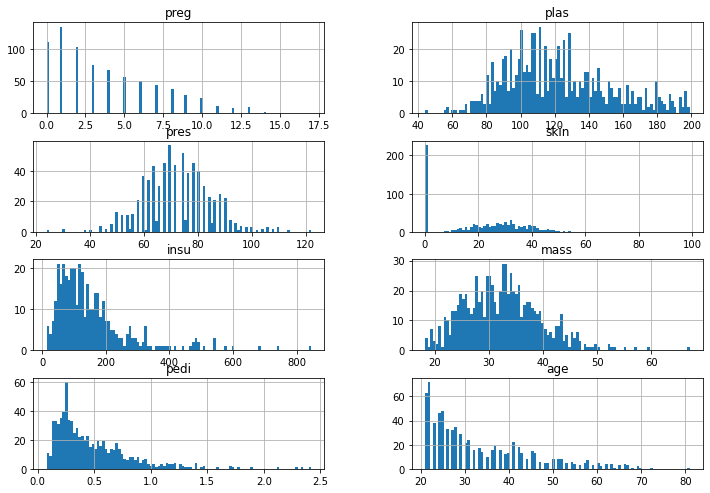

In [24]:
# original dataset 
columns = list(diabetesDF1)[0:-1] # Excluding 'class' column which has only 
diabetesDF1[columns].hist(stacked=False, bins=100, figsize=(12,30), layout=(14,2)); 
# Histogram of first 8 columns

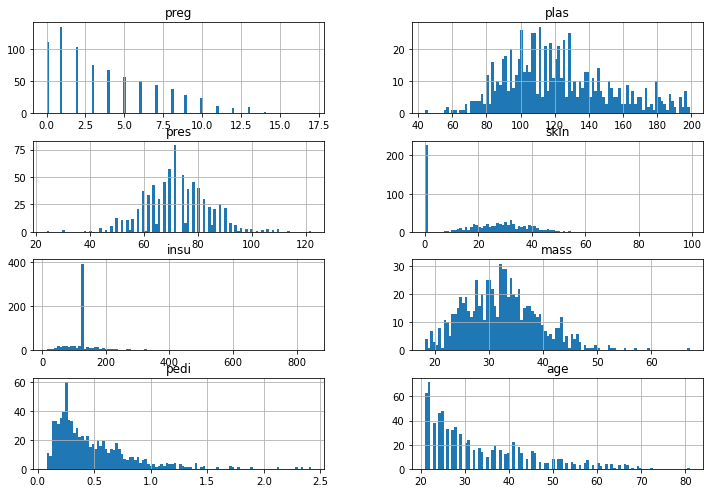

In [25]:
# cleaned dataset
columns = list(diabetesDF)[0:-1] # Excluding 'class' column which has only 
diabetesDF[columns].hist(stacked=False, bins=100, figsize=(12,30), layout=(14,2)); 
# Histogram of first 8 columns

##  Univaraite Analysis ###

In [26]:
diabetesDF.dtypes

preg       int64
plas     float64
pres     float64
skin       int64
insu     float64
mass     float64
pedi     float64
age        int64
class     object
dtype: object

In [27]:
# populate the list of numeric attributes and categorical attributes
num_list = []
cat_list = []

for column in diabetesDF:
 if is_numeric_dtype(diabetesDF[column]):
        num_list.append(column)
 elif is_string_dtype(diabetesDF[column]):
        cat_list.append(column)    

print("Numerical: ",num_list)
print("Categorical:  ",cat_list)

Numerical:  ['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age']
Categorical:   ['class']


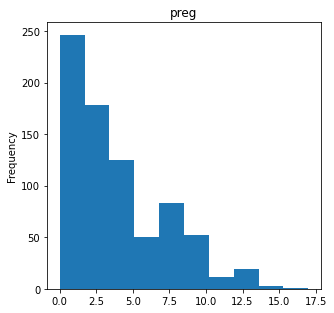

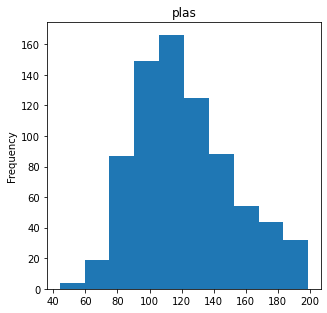

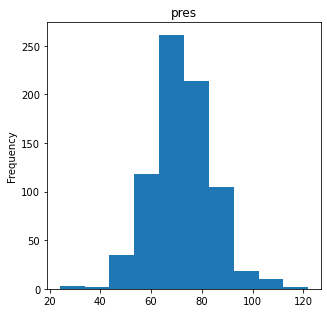

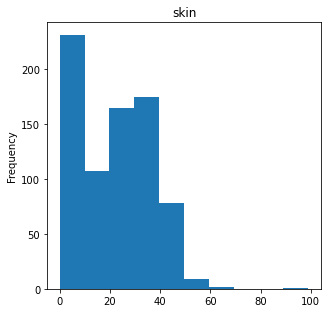

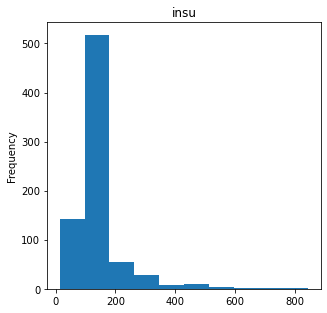

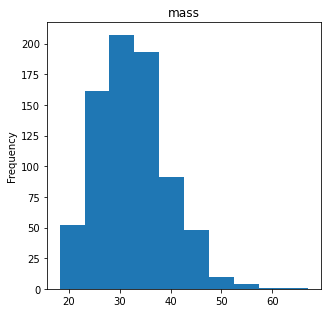

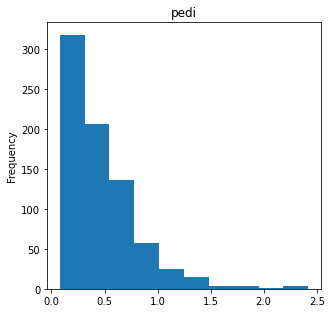

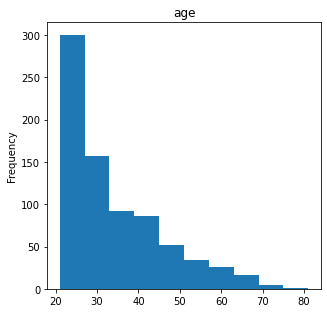

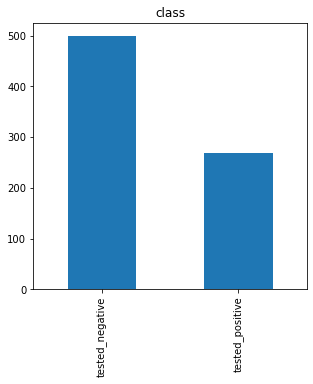

In [28]:
# bar chart and histogram
for column in diabetesDF:
    plt.figure(column, figsize = (4.9,4.9))
    plt.title(column)
    if is_numeric_dtype(diabetesDF[column]):
        diabetesDF[column].plot(kind = 'hist')
    elif is_string_dtype(diabetesDF[column]):
 # show only the TOP 10 value count in each categorical data
        diabetesDF[column].value_counts()[:10].plot(kind = 'bar')

###  Multivariate Analysis ###

<AxesSubplot:>

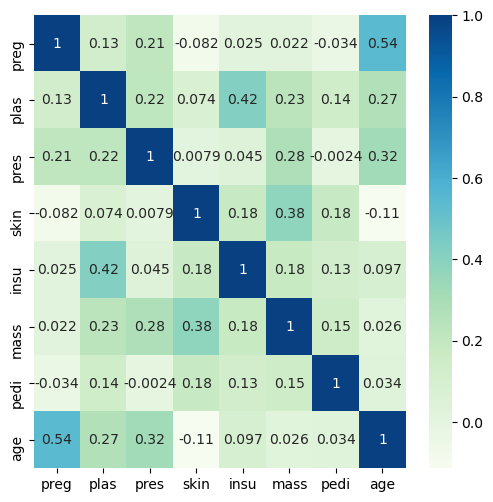

In [29]:
## Identify Correlation in data

# correation matrix and heatmap
correlation = diabetesDF.corr()

plt.figure(figsize= (6,6), dpi=100)
sns.heatmap(correlation, cmap = "GnBu", annot = True)

In above plot yellow colour represents maximum correlation and blue colour represents minimum correlation. We can see none of variable have correlation with any other variables.

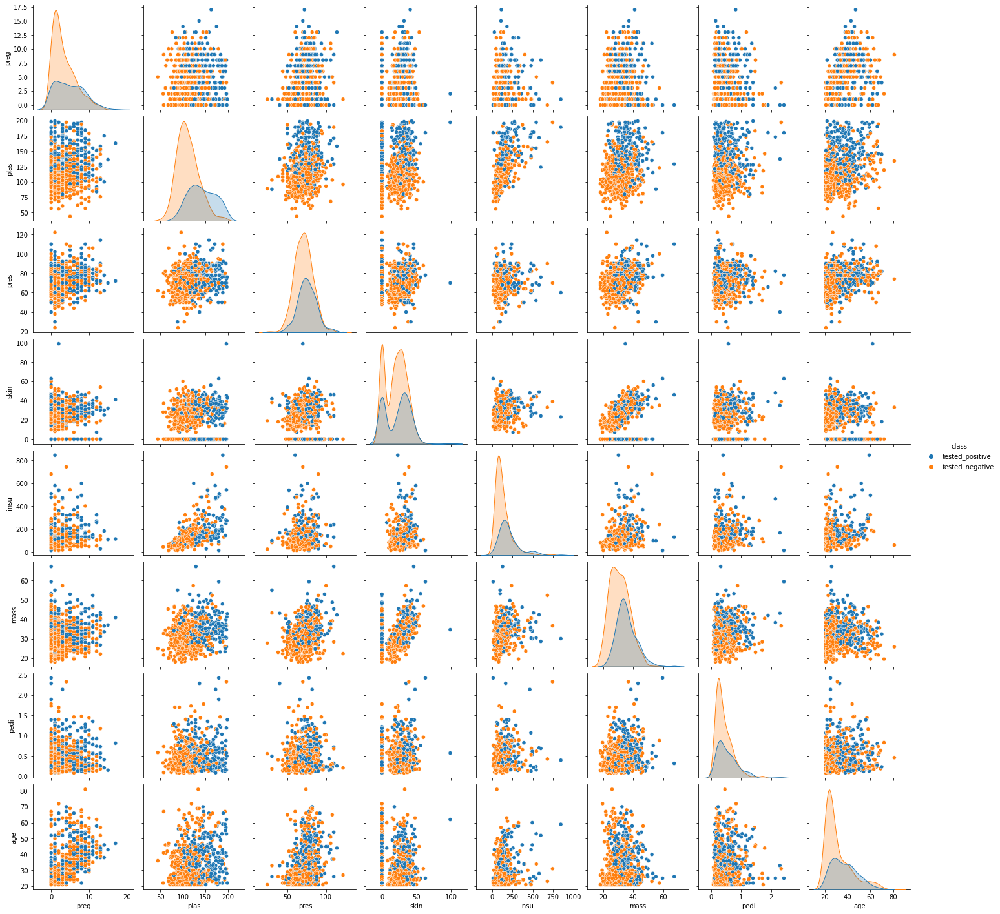

In [30]:
sns.pairplot(diabetesDF1,hue = 'class')

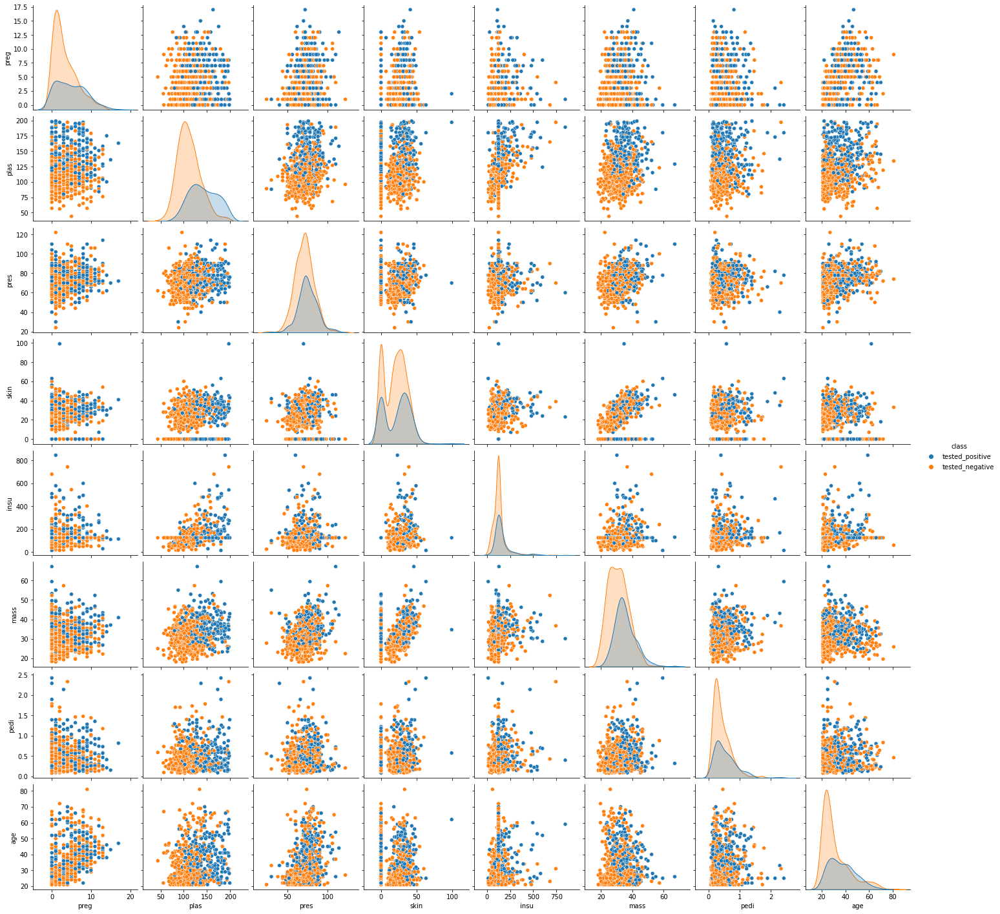

In [31]:
sns.pairplot(diabetesDF,diag_kind='kde',hue = 'class')

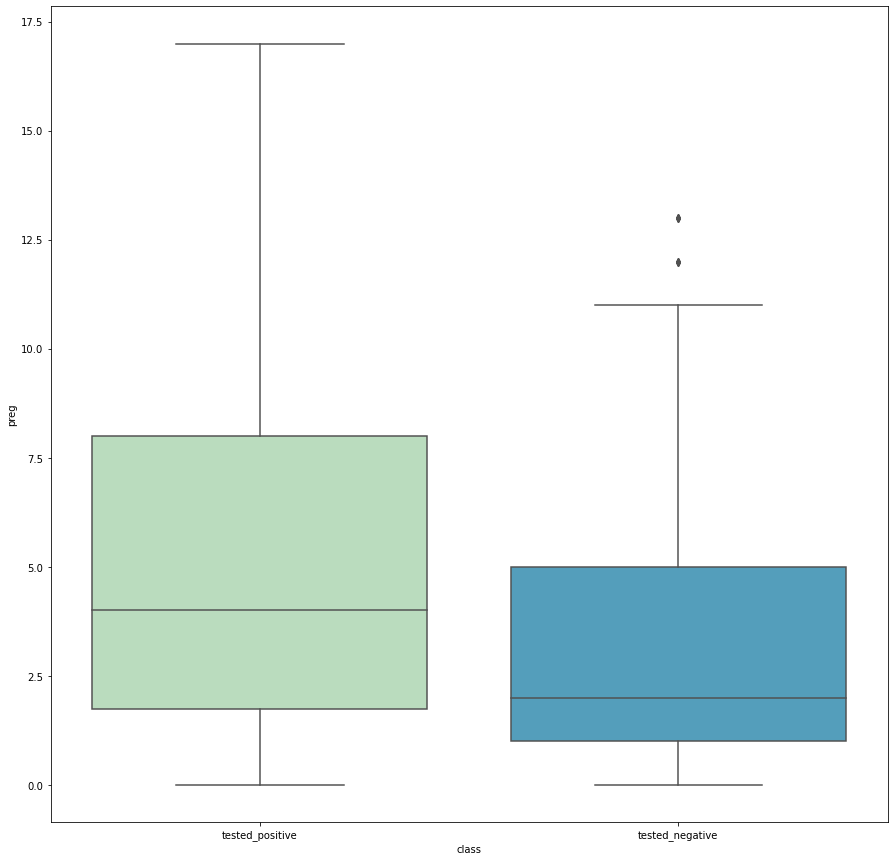

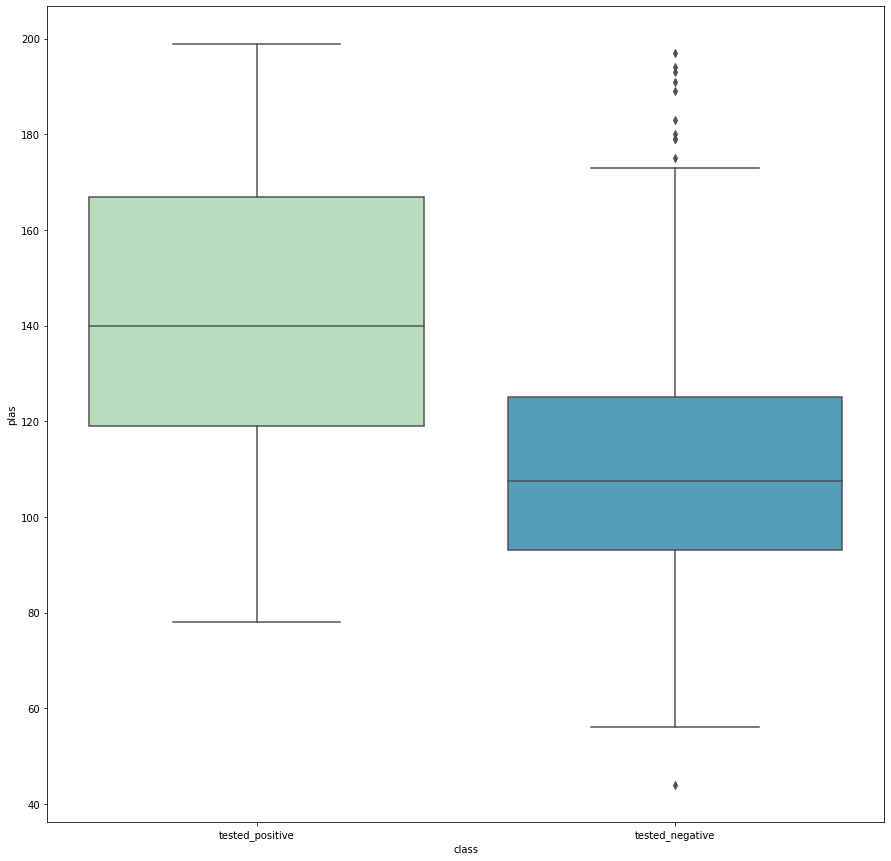

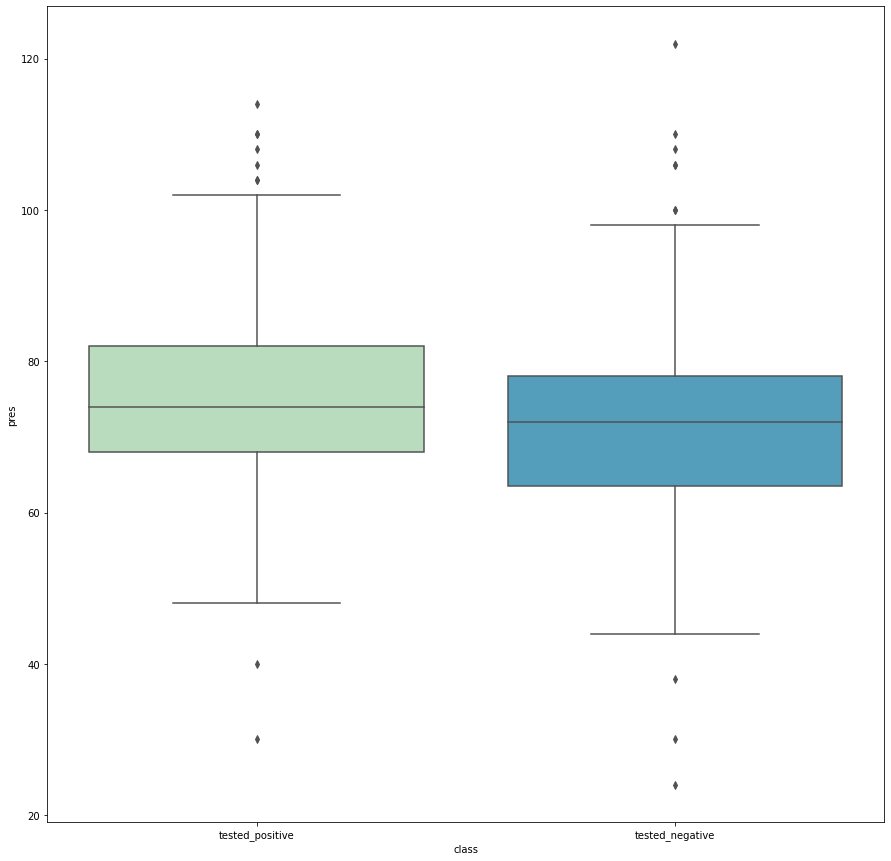

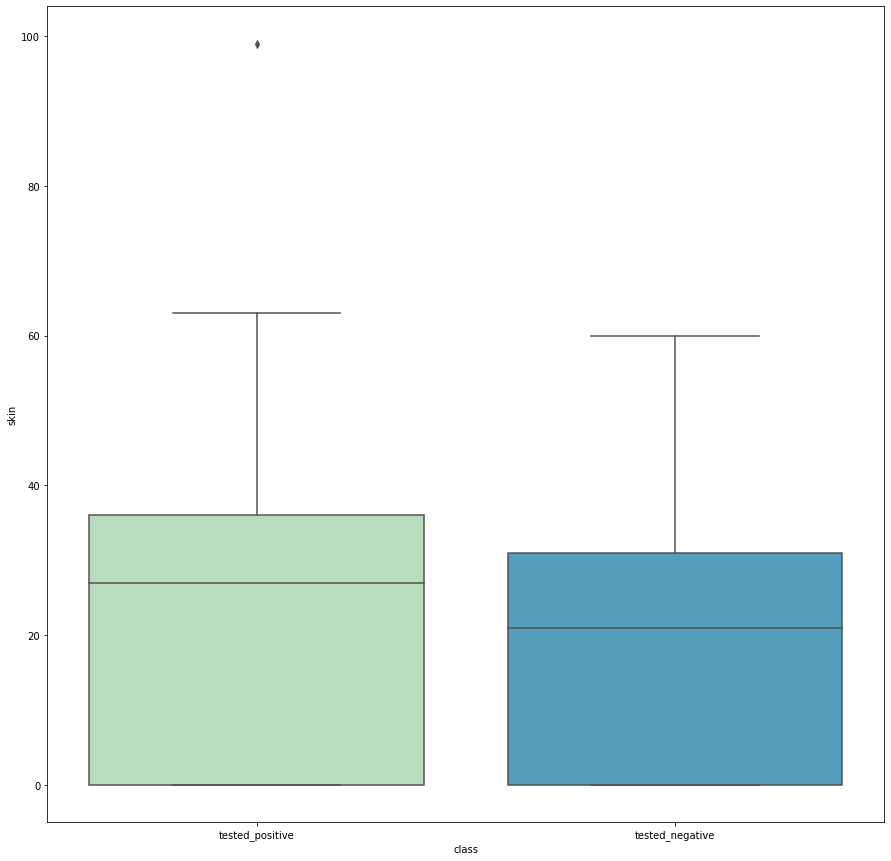

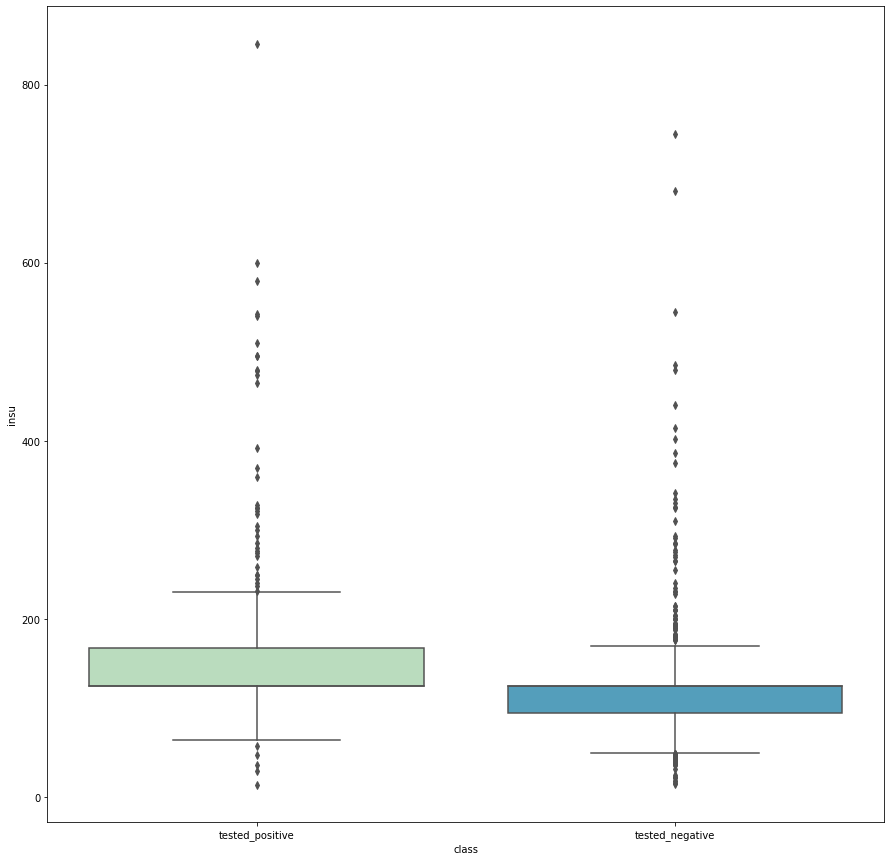

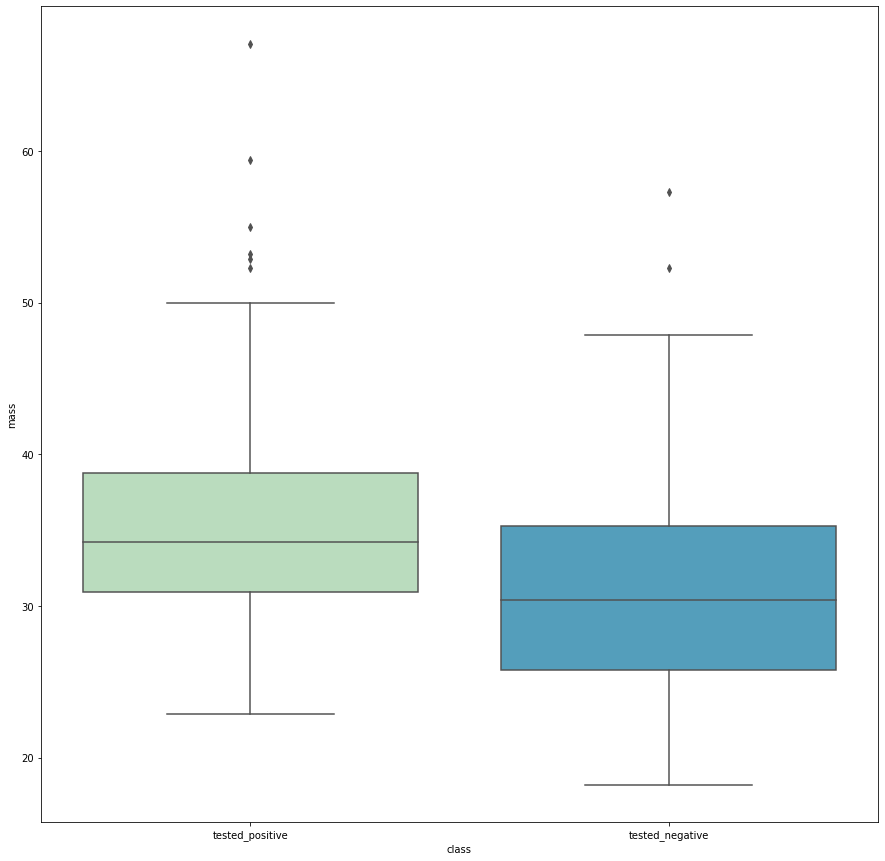

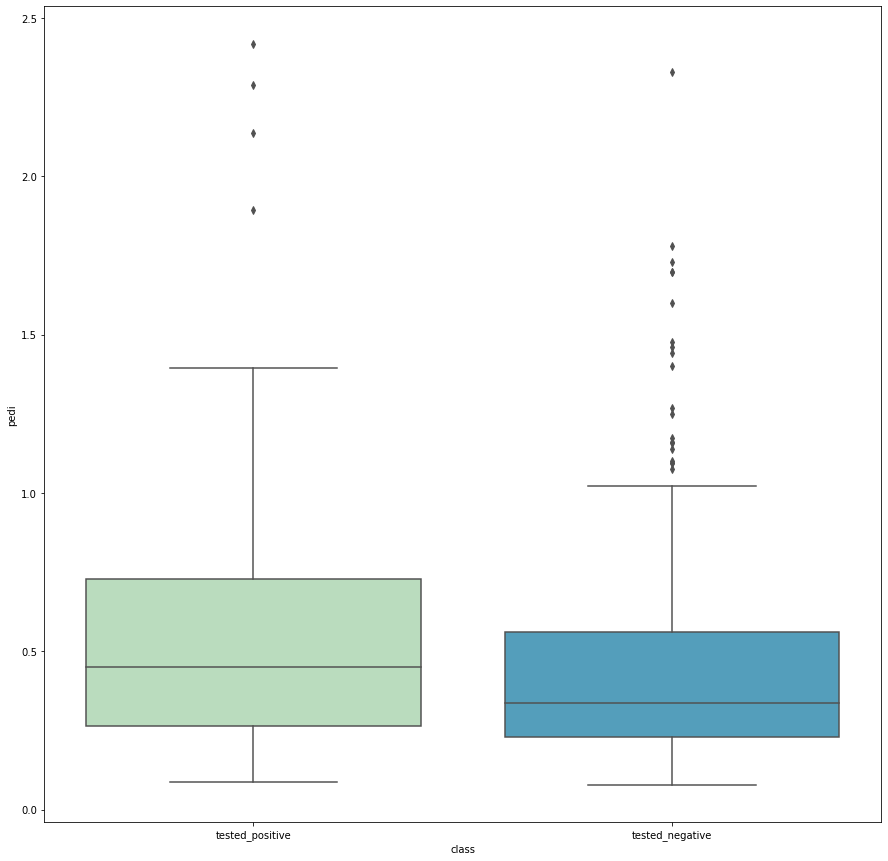

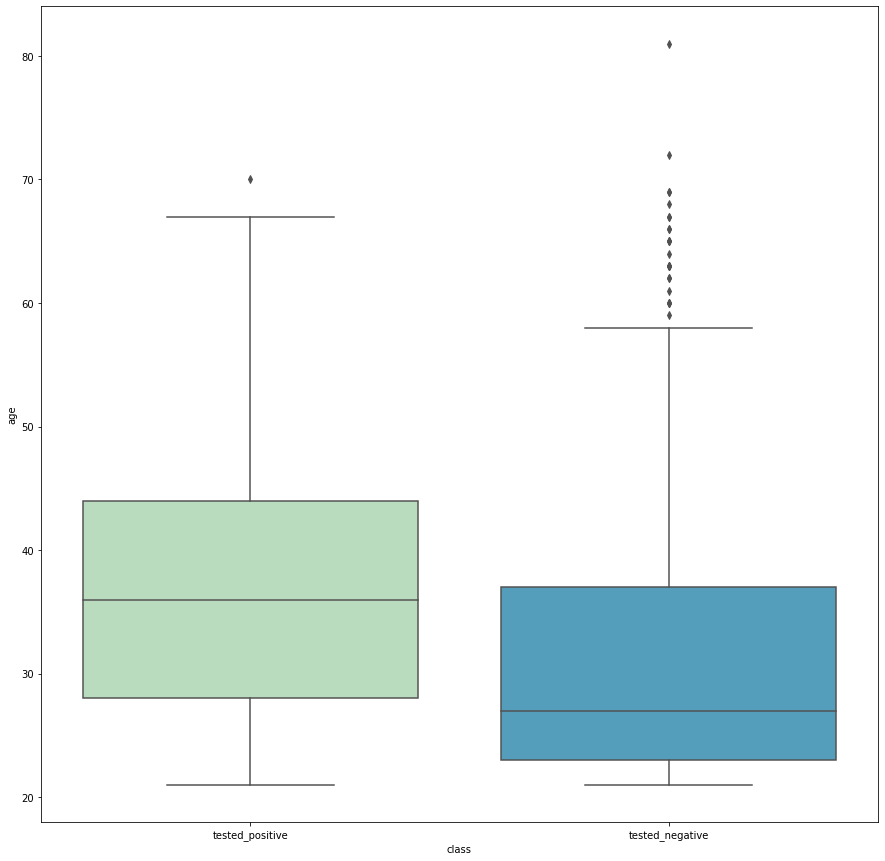

In [32]:
# box plot
for i in range(0, len(cat_list)):
    cat = cat_list[i]
    for j in range(0, len(num_list)):
        num = num_list[j]
        plt.figure (figsize = (15,15))
        sns.boxplot( x = cat, y = num, data = diabetesDF, palette = "GnBu")

## finding outliers 

In [33]:
from scipy import stats
import numpy as np

z = np.abs(stats.zscore(diabetesDF[diabetesDF.select_dtypes(exclude ='object').columns]))

print(z)

[[0.63994726 0.86604475 0.03198993 ... 0.16661938 0.46849198 1.4259954 ]
 [0.84488505 1.20506583 0.5283186  ... 0.85219976 0.36506078 0.19067191]
 [1.23388019 2.01666174 0.69376149 ... 1.33250021 0.60439732 0.10558415]
 ...
 [0.3429808  0.02157407 0.03198993 ... 0.910418   0.68519336 0.27575966]
 [0.84488505 0.14279979 1.02464727 ... 0.34279019 0.37110101 1.17073215]
 [0.84488505 0.94206766 0.19743282 ... 0.29912651 0.47378505 0.87137393]]


In [34]:
#An outlier of a dataset is defined as a value that is more than 3 standard deviations from the mean
diabetes_outlierOUT = diabetesDF[(z <= 3).all(axis=1)]

In [35]:
diabetes_outlierOUT.shape, diabetesDF.shape

((719, 9), (768, 9))

#An outlier of a dataset is defined as a value that is more than 3 standard deviations from the mean
diabetes_WITHoutlier = diabetesDF[((z >= 3) & (z >= -3) ).all(axis=1)]
diabetes_WITHoutlier.shape

In [36]:
import warnings
warnings.filterwarnings('ignore')
diabetesOUT_o1 = diabetesDF

Q1 = diabetesOUT_o1.quantile(0.25)
Q3 = diabetesOUT_o1.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

diabetes_outliersONLY = diabetesOUT_o1[((diabetesOUT_o1 < (Q1 - 25 * IQR)) | (diabetesOUT_o1 > (Q3 + 25 * IQR))).any(axis=1)]

diabetes_outliersONLY.shape

preg     5.0000
plas    40.5000
pres    16.0000
skin    32.0000
insu     5.7500
mass     9.1000
pedi     0.3825
age     17.0000
dtype: float64


(50, 9)

In [37]:
pp.ProfileReport(diabetes_outliersONLY)

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [38]:
diabetes_outliersONLY

,preg,plas,pres,skin,insu,mass,pedi,age,class
8,2,197.0,70.0,45,543.0,30.5,0.158,53,tested_positive
13,1,189.0,60.0,23,846.0,30.1,0.398,59,tested_positive
53,8,176.0,90.0,34,300.0,33.7,0.467,58,tested_positive
54,7,150.0,66.0,42,342.0,34.7,0.718,42,tested_negative
56,7,187.0,68.0,39,304.0,37.7,0.254,41,tested_positive
111,8,155.0,62.0,26,495.0,34.0,0.543,46,tested_positive
139,5,105.0,72.0,29,325.0,36.9,0.159,28,tested_negative
144,4,154.0,62.0,31,284.0,32.8,0.237,23,tested_negative
153,1,153.0,82.0,42,485.0,40.6,0.687,23,tested_negative
162,0,114.0,80.0,34,285.0,44.2,0.167,27,tested_negative


diabetes_outliersONLY : all these are accepted as valuable data 

In [39]:
# pp.ProfileReport(diabetes_outlierOUT)

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

## diabetes types classification

In [40]:
t1_t2 = diabetesDF[['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age']].astype('float')
t1_t2_clean = t1_t2[ (diabetesDF.pres > 0) & (diabetesDF.mass > 0) ]
t1_t2_clean

,preg,plas,pres,skin,insu,mass,pedi,age
0,6.0,148.0,72.0,35.0,125.0,33.6,0.627,50.0
1,1.0,85.0,66.0,29.0,125.0,26.6,0.351,31.0
2,8.0,183.0,64.0,0.0,125.0,23.3,0.672,32.0
3,1.0,89.0,66.0,23.0,94.0,28.1,0.167,21.0
4,0.0,137.0,40.0,35.0,168.0,43.1,2.288,33.0
...,...,...,...,...,...,...,...,...
763,10.0,101.0,76.0,48.0,180.0,32.9,0.171,63.0
764,2.0,122.0,70.0,27.0,125.0,36.8,0.340,27.0
765,5.0,121.0,72.0,23.0,112.0,26.2,0.245,30.0
766,1.0,126.0,60.0,0.0,125.0,30.1,0.349,47.0


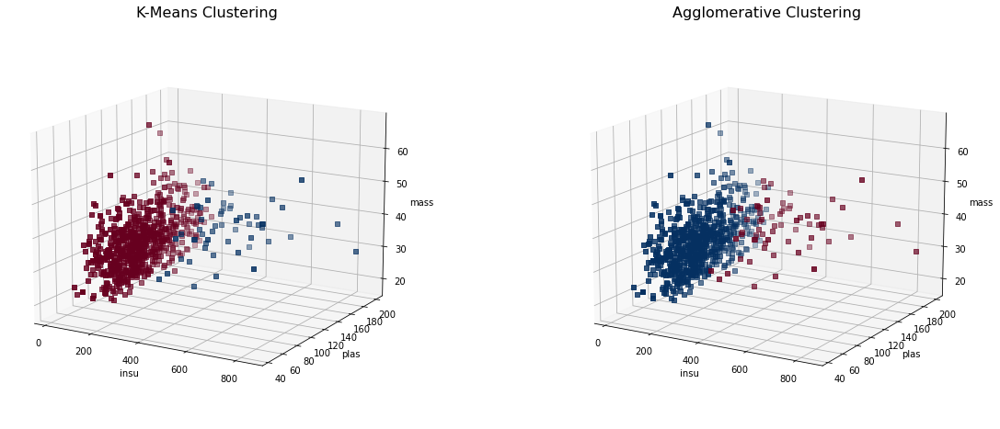

In [41]:
from sklearn.cluster import KMeans, AgglomerativeClustering

"""
Clustering to distinguish between type - I and type - II
"""

# Use standard K-Means with two clusters (type I/II) as a first step
kmeans = KMeans(n_clusters=2).fit(t1_t2_clean)

# For comparison, also use Agglomerative Clustering with two clusters (type I/II)
agglo = AgglomerativeClustering(n_clusters=2).fit(t1_t2_clean)


def plot_3D(df, label1, label2, title1, title2):
    #---- Parameters which are the same for both figures
    fig = plt.figure(figsize=(20,8))
    x = np.array(diabetesDF['insu'])
    y = np.array(diabetesDF['plas'])
    z = np.array(diabetesDF['mass'])

    #---- First subplot
    ax = fig.add_subplot(121, projection='3d')

    ax.scatter(x, y, z, marker="s", c=label1, s=25, cmap="RdBu")
    ax.set_title("%s" % title1, fontsize = 16)
    ax.set_xlabel('insu')
    ax.set_ylabel('plas')
    ax.set_zlabel('mass')
    ax.view_init(15) # rotation of the 3D plot

    #---- Second subplot
    ax = fig.add_subplot(122, projection='3d')

    ax.scatter(x, y, z, marker="s", c=label2, s=25, cmap="RdBu")    
    ax.set_title("%s" % title2, fontsize = 16)
    ax.set_xlabel('insu')
    ax.set_ylabel('plas')
    ax.set_zlabel('mass')
    ax.view_init(15) # rotation of the 3D plot

    plt.show()


# Visualize the results of both clustering algorithms in 3D
plot_3D(t1_t2_clean, kmeans.labels_, agglo.labels_, "K-Means Clustering", "Agglomerative Clustering")

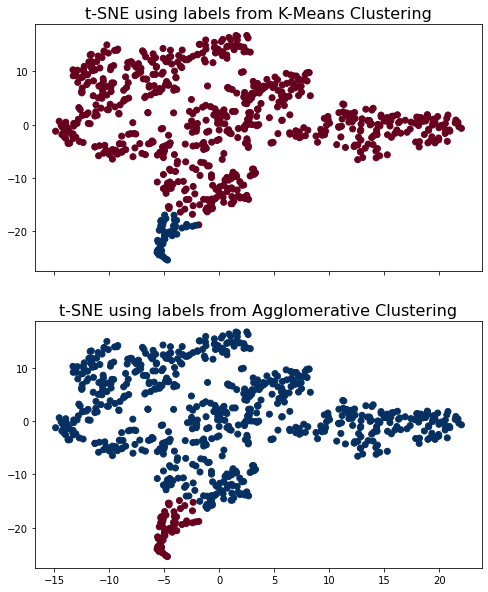

In [42]:
from sklearn.manifold import TSNE

"""
Use dimensionality reduction to visualize the separation of the two clusters
"""

# Perform tSNE on the values with two clusters (type I/II) as a first step
tsne = TSNE(n_components=2, n_iter=300).fit_transform(t1_t2_clean)




def plot_TSNE(df, label1, label2, title1, title2):
    fig, ax = plt.subplots(2, sharex=True, figsize=(8,10))

    ax[0].scatter(df[:,0], df[:,1], c = label1, cmap="RdBu")
    ax[0].set_title('t-SNE using labels from %s Clustering' % title1, fontsize = 16)

    ax[1].scatter(df[:,0], df[:,1], c = label2, cmap="RdBu")
    ax[1].set_title('t-SNE using labels from %s Clustering' % title2, fontsize = 16)

    fig.subplots_adjust(hspace=0.2)
    plt.show()



plot_TSNE(tsne, kmeans.labels_, agglo.labels_, "K-Means", "Agglomerative")


Kmeans clustering

╒═══════════╤═════════╤════════════╤═══════════╕
│ preg      │ plas    │ pres       │ skin      │
╞═══════════╪═════════╪════════════╪═══════════╡
│ Type - I  │ 3 +/- 3 │ 118 +/- 29 │ 72 +/- 12 │
├───────────┼─────────┼────────────┼───────────┤
│ Type - II │ 3 +/- 3 │ 156 +/- 25 │ 72 +/- 11 │
╘═══════════╧═════════╧════════════╧═══════════╛


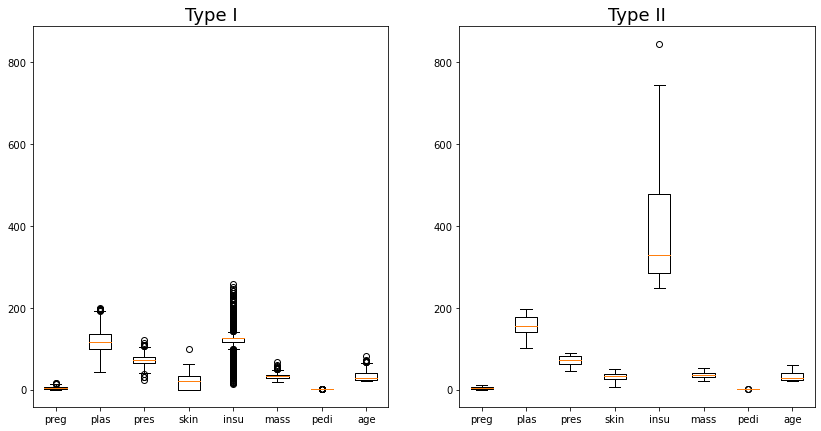

In [43]:
# Find the average BMI, BloodPressure and Age with their STD of each class; output a table


def print_tab(df, label):
    # Use the labels of KMeans, as they gave a better separation.
    mean1 = df[label == 0].mean(axis=0)
    std1 = df[label == 0].std(axis=0)

    mean2 = df[label == 1].mean(axis=0)
    std2 = df[label == 1].std(axis=0)

    print("")
    print("Kmeans clustering")
    
    print("")

    
    # Print the values in a table
    print( tabulate([['Type - I', "%i +/- %i"%(mean1[0],std1[0]), "%i +/- %i"%(mean1[1],std1[1]), "%i +/- %i"%(mean1[2],std1[2])], 
                     ['Type - II', "%i +/- %i"%(mean2[0],std2[0]), "%i +/- %i"%(mean2[1],std2[1]), "%i +/- %i"%(mean2[2],std2[2])]], 
                    headers=list(df), tablefmt="fancy_grid") )


print_tab(t1_t2_clean, kmeans.labels_)




def plot_boxplot(df, label):
    # Create a figure instance
    fig = plt.figure(figsize=(14,7))

    # Create the subplots, sharing the y axis
    ax1 = plt.subplot(121)
    plt.boxplot(df[label == 0].values)
    plt.setp(ax1, xticklabels=list(df))
    plt.title('Type I', fontsize=18)

    ax2 = plt.subplot(122, sharey=ax1)
    plt.boxplot(df[label == 1].values)
    plt.setp(ax2, xticklabels=list(df))
    plt.title('Type II', fontsize=18)

    plt.show()


# Visualize the result in a boxplot!
plot_boxplot(t1_t2_clean, kmeans.labels_)

Insulin resistance often develops before type 2 diabetes. At first, insulin resistance causes the body to make extra insulin, to make up for ineffective insulin. Extra insulin in the bloodstream can cause hypoglycemia. But insulin resistance tends to get worse over time. Eventually, it decreases your body's ability to make insulin. As insulin levels drop, blood sugar levels rise. If levels don't return to normal, you may get type 2 diabetes.

ref. https://medlineplus.gov/lab-tests/insulin-in-blood/

### Summary

Using only the features BloodPressure, BMI and Age, it is possible to visualize the data. Using tSNE on the data leads to a separation of the points in two dimensions; however, it is still not possible to clearly separate the data into certain clusters.

In order to reveal the difference between Diabetes Type I and Type II, the data is clustered with both KMeans and Agglomerative Clustering, using two as the number of clusters. KMeans is further used, as it manages to separate the data better than Agglomerative Clustering.

The boxplots as well as the tables show the differences between the two clusters well. As expected, one of the classes has higher values for the blood pressure, the BMI and the age. This is in accordance to the table above, which shows the major causes for Diabetes Type II. 

Before jumping to quick conclusions, it must be mentioned that the separation of the data into two clusters might have other causes. In order to analyze those potential causes, one could do further analysis with different number of clusters; like that, it is possible to find out the optimal number of clusters. Alternatively, having a dataset with labels for Diabetes Type I and Type II would increase the possibilities for analysis drastically. To concentrate on other aspects of this dataset, I will not cover those approaches here.

+++++++++++++++++++++++++++++++++++++

# PyCaret Classification 


## MODEL 0: The "Kitchen Sink" approach
predicting on the test dataset to record 2 main outcomes:

1. Capture feature importances from the fit procedure. The plan is to use the most important features later on with further preprocessing and parameter tuning
2. Capture classification results of this "base model" to compare future models and see which ones perform best.
Compare different models based on Accuracy, AUC, Recall, Prec., F1, Kappa, MCC,

In [44]:
dataset_pycaret = diabetesDF.copy()
dataset_pycaret.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   preg    768 non-null    int64  
 1   plas    768 non-null    float64
 2   pres    768 non-null    float64
 3   skin    768 non-null    int64  
 4   insu    768 non-null    float64
 5   mass    768 non-null    float64
 6   pedi    768 non-null    float64
 7   age     768 non-null    int64  
 8   class   768 non-null    object 
dtypes: float64(5), int64(3), object(1)
memory usage: 54.1+ KB


In [45]:
dataset_pycaret.columns

Index(['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age', 'class'], dtype='object')

## Experiment Setup

In [46]:
clf1 = setup(dataset_pycaret, 
             target = 'class', # Replace with your target variable.
             session_id=123, 
             log_experiment=True, 
             experiment_name='diabetes ML', # Optionally replace with your desired experiment name.
             silent=True # Runs the command without waiting for user input. 
            )

,Description,Value
0,session_id,123
1,Target,class
2,Target Type,Binary
3,Label Encoded,"tested_negative: 0, tested_positive: 1"
4,Original Data,"(768, 9)"
5,Missing Values,False
6,Numeric Features,7
7,Categorical Features,1
8,Ordinal Features,False
9,High Cardinality Features,False


In [47]:
### Compare Baseline Models
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [82]:
models()['Name'][2]

'Naive Bayes'

In [90]:
models()[:3]

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True


In [48]:
best_model = compare_models() 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.7786,0.8392,0.6000,0.7067,0.6418,0.4843,0.4929,1.3510
gbc,Gradient Boosting Classifier,0.7674,0.8343,0.5778,0.6948,0.6207,0.4565,0.4673,0.0500
ada,Ada Boost Classifier,0.7619,0.8053,0.6056,0.6556,0.6245,0.4519,0.4566,0.0360
lr,Logistic Regression,0.7582,0.8051,0.5111,0.6930,0.5838,0.4199,0.4322,0.2110
ridge,Ridge Classifier,0.7545,0.0000,0.5000,0.6954,0.5747,0.4095,0.4247,0.0130
lda,Linear Discriminant Analysis,0.7527,0.7942,0.4944,0.6929,0.5700,0.4041,0.4197,0.0070
rf,Random Forest Classifier,0.7526,0.8089,0.5222,0.6861,0.5810,0.4119,0.4268,0.0870
lightgbm,Light Gradient Boosting Machine,0.7524,0.8022,0.5833,0.6475,0.6101,0.4301,0.4343,0.0500
xgboost,Extreme Gradient Boosting,0.7414,0.7898,0.5944,0.6251,0.6053,0.4139,0.4173,0.1140
et,Extra Trees Classifier,0.7338,0.7690,0.4444,0.6643,0.5209,0.3494,0.3690,0.0840


In [49]:
#Compare ensemble models only.
print('Ensemble models: ', models(type='ensemble').index.tolist())

models_to_include = models(type='ensemble').index.tolist()#.remove('gbr')
print(models_to_include)

ensembled_models = compare_models(include = models_to_include, fold = 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.7523,0.8261,0.5389,0.6703,0.5940,0.4189,0.4267,1.2167
ada,Ada Boost Classifier,0.7505,0.7998,0.6000,0.6374,0.6151,0.4314,0.4342,0.0433
gbc,Gradient Boosting Classifier,0.7467,0.7952,0.5722,0.6350,0.5973,0.4149,0.4189,0.0467
et,Extra Trees Classifier,0.7467,0.7662,0.4778,0.6841,0.5583,0.3887,0.4038,0.1033
rf,Random Forest Classifier,0.7374,0.8016,0.4722,0.6581,0.5462,0.3687,0.3812,0.1000
lightgbm,Light Gradient Boosting Machine,0.7356,0.7944,0.5389,0.6293,0.5756,0.3864,0.3921,0.0333
xgboost,Extreme Gradient Boosting,0.7207,0.7763,0.5111,0.6020,0.5505,0.3503,0.3543,0.1100


In [50]:
# Select the best model based on the chosen metric
best = automl(optimize = 'Accuracy')
best

In [95]:
# Select the best model based on the chosen metric
best = automl(optimize = 'Recall')
best

QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)

## Analyze Models With Plots

In [1]:
%%time 
evaluate_model(best)

NameError: name 'evaluate_model' is not defined

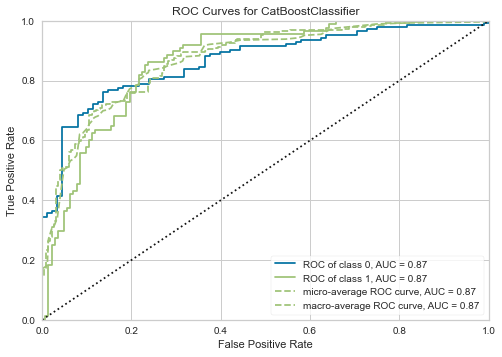

best model plot <catboost.core.CatBoostClassifier object at 0x000001A14B5D3100>


In [53]:

plot_model(best)
print('best model plot', best)


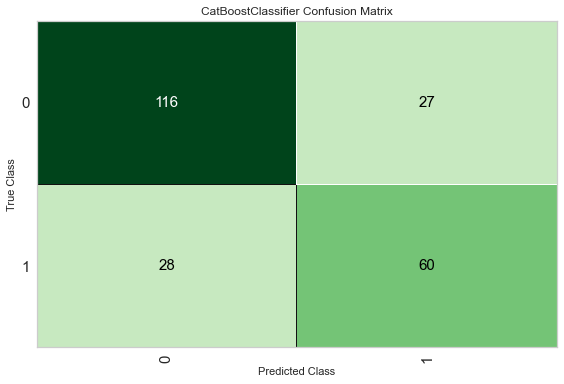

In [54]:
plot_model(best, plot = 'confusion_matrix')

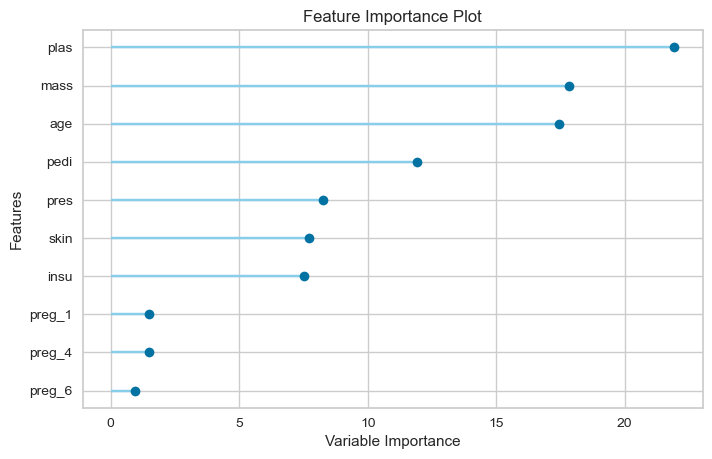

In [55]:
plot_model(best, plot = 'feature')

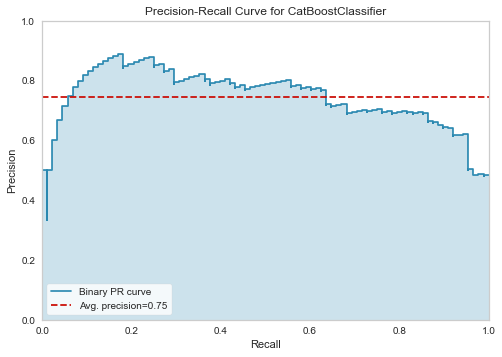

In [56]:
plot_model(best, plot = 'pr')

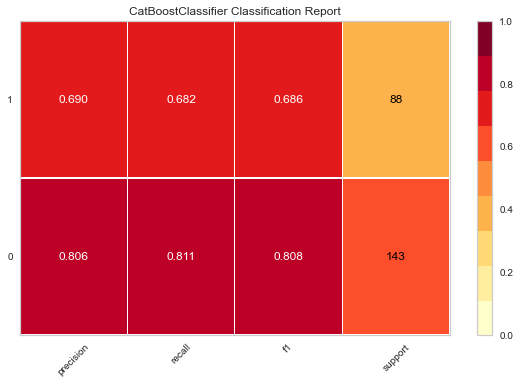

In [57]:
plot_model(best, plot = 'class_report')

### Interpret Models With SHAP

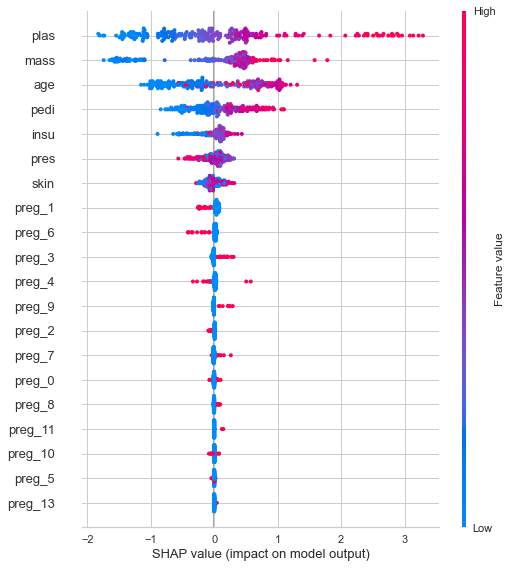

In [58]:
interpret_model(best)

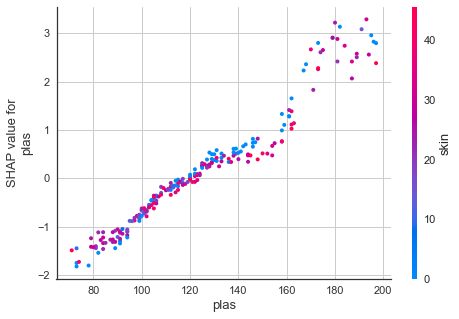

In [59]:
interpret_model(best, plot = 'correlation')

In [60]:
interpret_model(best, plot = 'reason', observation = 12)

## Predict

In [61]:
predict_model(best).head(10)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.7619,0.8655,0.6818,0.6897,0.6857,0.4941,0.4941


,plas,pres,skin,insu,mass,pedi,age,preg_0,preg_1,preg_10,...,preg_3,preg_4,preg_5,preg_6,preg_7,preg_8,preg_9,class,Label,Score
0,181.0,84.0,21.0,192.0,35.900002,0.586,51.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,tested_positive,tested_positive,0.9419
1,127.0,58.0,24.0,275.0,27.700001,1.600,25.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,tested_negative,tested_negative,0.7856
2,138.0,76.0,0.0,125.0,33.200001,0.420,35.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,tested_negative,tested_positive,0.7165
3,81.0,60.0,22.0,125.0,27.700001,0.290,25.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,tested_negative,tested_negative,0.9555
4,84.0,82.0,31.0,125.0,38.200001,0.233,23.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,tested_negative,tested_negative,0.9434
5,140.0,94.0,0.0,125.0,32.700001,0.734,45.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,tested_positive,tested_positive,0.7564
6,197.0,74.0,0.0,125.0,25.900000,1.191,39.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,tested_positive,tested_positive,0.8393
7,120.0,72.0,0.0,125.0,30.000000,0.183,38.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,tested_positive,tested_positive,0.5528
8,161.0,86.0,0.0,125.0,30.400000,0.165,47.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,tested_positive,tested_positive,0.5591
9,120.0,68.0,0.0,125.0,29.600000,0.709,34.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,tested_negative,tested_positive,0.6334


###  Save and Load Model

In [62]:
save_model(best, model_name='best-model')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='class',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strat...
                 ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                 ('cluster_all', 'passthrough'),
                 ('dummy', Dummify(target='class')),
                 ('fix_perfect', Remove_100(target='class')),
                 ('clean_names', Cl

In [63]:
loaded_bestmodel = load_model('best-model')
print(loaded_bestmodel)

Transformation Pipeline and Model Successfully Loaded
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=False, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='class',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strat...
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='class')),
                ('fix_perfect', Remove_100(target='class'))

# (((((((((((((((((((((((((((((((((((((((((((((()))))))))))))))))))))))))))))))))))))))))))))))))))

In [ ]:
Modle 1 

In [132]:
from sklearn.model_selection import train_test_split
y = diabetesDF['class']
X = diabetesDF.drop('class', axis=1)


#we will be splitting the following data into labels and features. Labels are the data which we want to predict and features are the data which are used to predict labels.
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.4)

In [133]:
#GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingClassifier
clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,
       max_depth=1, random_state=0).fit(X_train, y_train)
clf.score(X_test, y_test)
print("GBC Accuracy = ", clf.score(X_test, y_test) * 100 , "%")

coef_df = pd.DataFrame(model.coef_)
coef_df['intercept'] = model.intercept_
print(coef_df)
print(diabetesDF.columns)




GBC Accuracy =  72.07792207792207 %
          0         1       2         3         4         5         6  \
0  0.089205  0.024097 -0.0282 -0.008563  0.000415  0.058144  0.782994   

         7  intercept  
0  0.01002  -4.406972  
Index(['preg', 'plas', 'pres', 'skin', 'insu', 'mass', 'pedi', 'age', 'class'], dtype='object')


In [134]:
from sklearn.linear_model import LogisticRegression

# Fit the model on train
model = LogisticRegression(solver="liblinear")
model.fit(X_train, y_train)
#predict on test
y_predict = model.predict(X_test)

model_accuracy = model.score(X_test, y_test)
print("Logistic Regression Accuracy = ", model_accuracy * 100 , "%")


from sklearn.metrics import classification_report

print(classification_report(y_test, y_predict))

Logistic Regression Accuracy =  76.2987012987013 %
                 precision    recall  f1-score   support

tested_negative       0.75      0.91      0.82       187
tested_positive       0.80      0.53      0.64       121

       accuracy                           0.76       308
      macro avg       0.78      0.72      0.73       308
   weighted avg       0.77      0.76      0.75       308



## catboost.core.CatBoostClassifier


In [136]:
from catboost import Pool, CatBoostClassifier, cv
import numpy as np
np.set_printoptions(precision=4)
import catboost
from catboost import *

In [145]:
rnd_state = 42

categorical_features_indices = np.where(X.dtypes != np.float)[0]

clf = CatBoostClassifier(random_seed=rnd_state)

clf.fit(X_train, y_train, cat_features=categorical_features_indices)
clf.score(X_test, y_test)

Learning rate set to 0.007395
0:	learn: 0.6889244	total: 21.7ms	remaining: 21.7s
1:	learn: 0.6843173	total: 47.3ms	remaining: 23.6s
2:	learn: 0.6810862	total: 73.5ms	remaining: 24.4s
3:	learn: 0.6769408	total: 99.6ms	remaining: 24.8s
4:	learn: 0.6729635	total: 125ms	remaining: 25s
5:	learn: 0.6692819	total: 153ms	remaining: 25.3s
6:	learn: 0.6652807	total: 182ms	remaining: 25.8s
7:	learn: 0.6620805	total: 213ms	remaining: 26.5s
8:	learn: 0.6580981	total: 243ms	remaining: 26.8s
9:	learn: 0.6544705	total: 270ms	remaining: 26.8s
10:	learn: 0.6512881	total: 299ms	remaining: 26.9s
11:	learn: 0.6477793	total: 327ms	remaining: 27s
12:	learn: 0.6446411	total: 355ms	remaining: 27s
13:	learn: 0.6413880	total: 385ms	remaining: 27.1s
14:	learn: 0.6375492	total: 414ms	remaining: 27.2s
15:	learn: 0.6337905	total: 442ms	remaining: 27.2s
16:	learn: 0.6309125	total: 469ms	remaining: 27.1s
17:	learn: 0.6285484	total: 495ms	remaining: 27s
18:	learn: 0.6254730	total: 523ms	remaining: 27s
19:	learn: 0.6232

162:	learn: 0.4283967	total: 4.34s	remaining: 22.3s
163:	learn: 0.4280855	total: 4.37s	remaining: 22.3s
164:	learn: 0.4274369	total: 4.39s	remaining: 22.2s
165:	learn: 0.4266788	total: 4.42s	remaining: 22.2s
166:	learn: 0.4260042	total: 4.45s	remaining: 22.2s
167:	learn: 0.4251525	total: 4.47s	remaining: 22.2s
168:	learn: 0.4244789	total: 4.5s	remaining: 22.1s
169:	learn: 0.4233705	total: 4.53s	remaining: 22.1s
170:	learn: 0.4226064	total: 4.56s	remaining: 22.1s
171:	learn: 0.4220363	total: 4.59s	remaining: 22.1s
172:	learn: 0.4213184	total: 4.62s	remaining: 22.1s
173:	learn: 0.4208309	total: 4.65s	remaining: 22.1s
174:	learn: 0.4201048	total: 4.68s	remaining: 22.1s
175:	learn: 0.4196967	total: 4.71s	remaining: 22s
176:	learn: 0.4190603	total: 4.74s	remaining: 22s
177:	learn: 0.4183560	total: 4.77s	remaining: 22s
178:	learn: 0.4181185	total: 4.79s	remaining: 22s
179:	learn: 0.4173899	total: 4.82s	remaining: 21.9s
180:	learn: 0.4167495	total: 4.84s	remaining: 21.9s
181:	learn: 0.4163513

324:	learn: 0.3561183	total: 8.63s	remaining: 17.9s
325:	learn: 0.3557594	total: 8.65s	remaining: 17.9s
326:	learn: 0.3555326	total: 8.68s	remaining: 17.9s
327:	learn: 0.3554117	total: 8.71s	remaining: 17.8s
328:	learn: 0.3548615	total: 8.73s	remaining: 17.8s
329:	learn: 0.3547981	total: 8.75s	remaining: 17.8s
330:	learn: 0.3543569	total: 8.77s	remaining: 17.7s
331:	learn: 0.3539862	total: 8.8s	remaining: 17.7s
332:	learn: 0.3537380	total: 8.83s	remaining: 17.7s
333:	learn: 0.3533660	total: 8.86s	remaining: 17.7s
334:	learn: 0.3531190	total: 8.88s	remaining: 17.6s
335:	learn: 0.3526534	total: 8.91s	remaining: 17.6s
336:	learn: 0.3526363	total: 8.93s	remaining: 17.6s
337:	learn: 0.3522830	total: 8.96s	remaining: 17.5s
338:	learn: 0.3516652	total: 8.99s	remaining: 17.5s
339:	learn: 0.3515137	total: 9.02s	remaining: 17.5s
340:	learn: 0.3512595	total: 9.05s	remaining: 17.5s
341:	learn: 0.3511804	total: 9.06s	remaining: 17.4s
342:	learn: 0.3509968	total: 9.09s	remaining: 17.4s
343:	learn: 0

486:	learn: 0.3121986	total: 12.9s	remaining: 13.6s
487:	learn: 0.3116056	total: 13s	remaining: 13.6s
488:	learn: 0.3113294	total: 13s	remaining: 13.6s
489:	learn: 0.3111199	total: 13s	remaining: 13.6s
490:	learn: 0.3108414	total: 13.1s	remaining: 13.5s
491:	learn: 0.3107291	total: 13.1s	remaining: 13.5s
492:	learn: 0.3105085	total: 13.1s	remaining: 13.5s
493:	learn: 0.3104415	total: 13.1s	remaining: 13.4s
494:	learn: 0.3103050	total: 13.2s	remaining: 13.4s
495:	learn: 0.3101600	total: 13.2s	remaining: 13.4s
496:	learn: 0.3098320	total: 13.2s	remaining: 13.4s
497:	learn: 0.3094962	total: 13.2s	remaining: 13.3s
498:	learn: 0.3092020	total: 13.3s	remaining: 13.3s
499:	learn: 0.3089760	total: 13.3s	remaining: 13.3s
500:	learn: 0.3087452	total: 13.3s	remaining: 13.3s
501:	learn: 0.3084905	total: 13.3s	remaining: 13.2s
502:	learn: 0.3084172	total: 13.4s	remaining: 13.2s
503:	learn: 0.3080849	total: 13.4s	remaining: 13.2s
504:	learn: 0.3079416	total: 13.4s	remaining: 13.2s
505:	learn: 0.3078

649:	learn: 0.2769625	total: 17.4s	remaining: 9.35s
650:	learn: 0.2767429	total: 17.4s	remaining: 9.32s
651:	learn: 0.2765245	total: 17.4s	remaining: 9.3s
652:	learn: 0.2762861	total: 17.4s	remaining: 9.27s
653:	learn: 0.2759741	total: 17.5s	remaining: 9.25s
654:	learn: 0.2758390	total: 17.5s	remaining: 9.22s
655:	learn: 0.2757527	total: 17.5s	remaining: 9.2s
656:	learn: 0.2754981	total: 17.6s	remaining: 9.17s
657:	learn: 0.2752927	total: 17.6s	remaining: 9.14s
658:	learn: 0.2751734	total: 17.6s	remaining: 9.12s
659:	learn: 0.2750000	total: 17.7s	remaining: 9.09s
660:	learn: 0.2748246	total: 17.7s	remaining: 9.07s
661:	learn: 0.2747860	total: 17.7s	remaining: 9.04s
662:	learn: 0.2744827	total: 17.7s	remaining: 9.01s
663:	learn: 0.2743408	total: 17.8s	remaining: 8.98s
664:	learn: 0.2743205	total: 17.8s	remaining: 8.95s
665:	learn: 0.2739608	total: 17.8s	remaining: 8.93s
666:	learn: 0.2736228	total: 17.8s	remaining: 8.9s
667:	learn: 0.2733668	total: 17.9s	remaining: 8.87s
668:	learn: 0.2

810:	learn: 0.2476842	total: 21.8s	remaining: 5.08s
811:	learn: 0.2475614	total: 21.8s	remaining: 5.05s
812:	learn: 0.2473730	total: 21.9s	remaining: 5.03s
813:	learn: 0.2472927	total: 21.9s	remaining: 5s
814:	learn: 0.2471611	total: 21.9s	remaining: 4.97s
815:	learn: 0.2470689	total: 21.9s	remaining: 4.95s
816:	learn: 0.2470660	total: 21.9s	remaining: 4.92s
817:	learn: 0.2470216	total: 22s	remaining: 4.89s
818:	learn: 0.2469260	total: 22s	remaining: 4.86s
819:	learn: 0.2467255	total: 22s	remaining: 4.83s
820:	learn: 0.2466102	total: 22.1s	remaining: 4.81s
821:	learn: 0.2465943	total: 22.1s	remaining: 4.78s
822:	learn: 0.2464217	total: 22.1s	remaining: 4.75s
823:	learn: 0.2463341	total: 22.1s	remaining: 4.73s
824:	learn: 0.2461608	total: 22.2s	remaining: 4.7s
825:	learn: 0.2459083	total: 22.2s	remaining: 4.67s
826:	learn: 0.2457771	total: 22.2s	remaining: 4.65s
827:	learn: 0.2456597	total: 22.2s	remaining: 4.62s
828:	learn: 0.2455308	total: 22.3s	remaining: 4.59s
829:	learn: 0.2453393	

972:	learn: 0.2212192	total: 26.2s	remaining: 727ms
973:	learn: 0.2209893	total: 26.2s	remaining: 700ms
974:	learn: 0.2208685	total: 26.3s	remaining: 673ms
975:	learn: 0.2206530	total: 26.3s	remaining: 646ms
976:	learn: 0.2205515	total: 26.3s	remaining: 619ms
977:	learn: 0.2202837	total: 26.3s	remaining: 592ms
978:	learn: 0.2202077	total: 26.4s	remaining: 565ms
979:	learn: 0.2200695	total: 26.4s	remaining: 539ms
980:	learn: 0.2199133	total: 26.4s	remaining: 512ms
981:	learn: 0.2197927	total: 26.4s	remaining: 485ms
982:	learn: 0.2197441	total: 26.5s	remaining: 458ms
983:	learn: 0.2195439	total: 26.5s	remaining: 431ms
984:	learn: 0.2194524	total: 26.5s	remaining: 404ms
985:	learn: 0.2192558	total: 26.5s	remaining: 377ms
986:	learn: 0.2191712	total: 26.6s	remaining: 350ms
987:	learn: 0.2190016	total: 26.6s	remaining: 323ms
988:	learn: 0.2189476	total: 26.6s	remaining: 296ms
989:	learn: 0.2188966	total: 26.7s	remaining: 269ms
990:	learn: 0.2188362	total: 26.7s	remaining: 242ms
991:	learn: 

0.75

42= 0.75 
30 = 76.94
F 0.7786
S 0.7523


In [140]:
# Submission 1: catboost submission with all training data and early stopping on Accuracy
#test_df = pd.read_csv('../input/test.csv', index_col='PassengerId')
#test_df.fillna(-999, inplace=True)
clf_od = CatBoostClassifier(random_seed=rnd_state, od_type='Iter', od_wait=20, eval_metric='Accuracy')
clf_od.fit(X, y, cat_features=categorical_features_indices)

clf_od.score(X_test, y_test)

Learning rate set to 0.009204
0:	learn: 0.7434896	total: 22ms	remaining: 22s
1:	learn: 0.7721354	total: 44.4ms	remaining: 22.2s
2:	learn: 0.7812500	total: 70.4ms	remaining: 23.4s
3:	learn: 0.7786458	total: 98.8ms	remaining: 24.6s
4:	learn: 0.7760417	total: 125ms	remaining: 24.8s
5:	learn: 0.7773438	total: 152ms	remaining: 25.1s
6:	learn: 0.7747396	total: 174ms	remaining: 24.6s
7:	learn: 0.7812500	total: 205ms	remaining: 25.4s
8:	learn: 0.7786458	total: 232ms	remaining: 25.6s
9:	learn: 0.7760417	total: 259ms	remaining: 25.6s
10:	learn: 0.7773438	total: 285ms	remaining: 25.6s
11:	learn: 0.7825521	total: 313ms	remaining: 25.8s
12:	learn: 0.7812500	total: 340ms	remaining: 25.8s
13:	learn: 0.7812500	total: 370ms	remaining: 26.1s
14:	learn: 0.7773438	total: 399ms	remaining: 26.2s
15:	learn: 0.7773438	total: 428ms	remaining: 26.3s
16:	learn: 0.7851563	total: 459ms	remaining: 26.5s
17:	learn: 0.7877604	total: 488ms	remaining: 26.6s
18:	learn: 0.7864583	total: 519ms	remaining: 26.8s
19:	learn: 

161:	learn: 0.8151042	total: 4.37s	remaining: 22.6s
162:	learn: 0.8151042	total: 4.39s	remaining: 22.6s
163:	learn: 0.8151042	total: 4.42s	remaining: 22.5s
164:	learn: 0.8164063	total: 4.45s	remaining: 22.5s
165:	learn: 0.8164063	total: 4.47s	remaining: 22.5s
166:	learn: 0.8164063	total: 4.5s	remaining: 22.5s
167:	learn: 0.8164063	total: 4.53s	remaining: 22.4s
168:	learn: 0.8164063	total: 4.56s	remaining: 22.4s
169:	learn: 0.8164063	total: 4.58s	remaining: 22.4s
170:	learn: 0.8177083	total: 4.61s	remaining: 22.4s
171:	learn: 0.8177083	total: 4.64s	remaining: 22.3s
172:	learn: 0.8177083	total: 4.67s	remaining: 22.3s
173:	learn: 0.8177083	total: 4.69s	remaining: 22.3s
174:	learn: 0.8177083	total: 4.71s	remaining: 22.2s
175:	learn: 0.8190104	total: 4.74s	remaining: 22.2s
176:	learn: 0.8190104	total: 4.77s	remaining: 22.2s
177:	learn: 0.8190104	total: 4.8s	remaining: 22.2s
178:	learn: 0.8190104	total: 4.83s	remaining: 22.1s
179:	learn: 0.8190104	total: 4.86s	remaining: 22.1s
180:	learn: 0.

326:	learn: 0.8593750	total: 8.81s	remaining: 18.1s
327:	learn: 0.8593750	total: 8.84s	remaining: 18.1s
328:	learn: 0.8606771	total: 8.87s	remaining: 18.1s
329:	learn: 0.8606771	total: 8.89s	remaining: 18.1s
330:	learn: 0.8606771	total: 8.92s	remaining: 18s
331:	learn: 0.8606771	total: 8.95s	remaining: 18s
332:	learn: 0.8619792	total: 8.97s	remaining: 18s
333:	learn: 0.8619792	total: 9s	remaining: 17.9s
334:	learn: 0.8619792	total: 9.03s	remaining: 17.9s
335:	learn: 0.8619792	total: 9.05s	remaining: 17.9s
336:	learn: 0.8619792	total: 9.09s	remaining: 17.9s
337:	learn: 0.8619792	total: 9.12s	remaining: 17.9s
338:	learn: 0.8619792	total: 9.14s	remaining: 17.8s
339:	learn: 0.8619792	total: 9.17s	remaining: 17.8s
340:	learn: 0.8619792	total: 9.2s	remaining: 17.8s
341:	learn: 0.8632813	total: 9.23s	remaining: 17.8s
342:	learn: 0.8619792	total: 9.26s	remaining: 17.7s
343:	learn: 0.8619792	total: 9.28s	remaining: 17.7s
344:	learn: 0.8619792	total: 9.3s	remaining: 17.7s
345:	learn: 0.8619792	t

485:	learn: 0.8828125	total: 13s	remaining: 13.7s
486:	learn: 0.8841146	total: 13s	remaining: 13.7s
487:	learn: 0.8828125	total: 13s	remaining: 13.7s
488:	learn: 0.8828125	total: 13.1s	remaining: 13.7s
489:	learn: 0.8828125	total: 13.1s	remaining: 13.6s
490:	learn: 0.8828125	total: 13.1s	remaining: 13.6s
491:	learn: 0.8828125	total: 13.1s	remaining: 13.6s
492:	learn: 0.8828125	total: 13.2s	remaining: 13.5s
493:	learn: 0.8828125	total: 13.2s	remaining: 13.5s
494:	learn: 0.8828125	total: 13.2s	remaining: 13.5s
495:	learn: 0.8828125	total: 13.3s	remaining: 13.5s
496:	learn: 0.8828125	total: 13.3s	remaining: 13.4s
497:	learn: 0.8841146	total: 13.3s	remaining: 13.4s
498:	learn: 0.8841146	total: 13.3s	remaining: 13.4s
499:	learn: 0.8841146	total: 13.4s	remaining: 13.4s
500:	learn: 0.8841146	total: 13.4s	remaining: 13.3s
501:	learn: 0.8841146	total: 13.4s	remaining: 13.3s
502:	learn: 0.8841146	total: 13.4s	remaining: 13.3s
503:	learn: 0.8841146	total: 13.5s	remaining: 13.3s
504:	learn: 0.8841

645:	learn: 0.9036458	total: 17.2s	remaining: 9.42s
646:	learn: 0.9036458	total: 17.2s	remaining: 9.4s
647:	learn: 0.9049479	total: 17.2s	remaining: 9.37s
648:	learn: 0.9036458	total: 17.3s	remaining: 9.34s
649:	learn: 0.9036458	total: 17.3s	remaining: 9.32s
650:	learn: 0.9036458	total: 17.3s	remaining: 9.29s
651:	learn: 0.9036458	total: 17.4s	remaining: 9.26s
652:	learn: 0.9036458	total: 17.4s	remaining: 9.24s
653:	learn: 0.9036458	total: 17.4s	remaining: 9.21s
654:	learn: 0.9036458	total: 17.4s	remaining: 9.19s
655:	learn: 0.9036458	total: 17.5s	remaining: 9.16s
656:	learn: 0.9036458	total: 17.5s	remaining: 9.13s
657:	learn: 0.9036458	total: 17.5s	remaining: 9.11s
658:	learn: 0.9049479	total: 17.5s	remaining: 9.08s
659:	learn: 0.9049479	total: 17.6s	remaining: 9.04s
660:	learn: 0.9049479	total: 17.6s	remaining: 9.02s
661:	learn: 0.9049479	total: 17.6s	remaining: 8.99s
662:	learn: 0.9049479	total: 17.6s	remaining: 8.97s
663:	learn: 0.9049479	total: 17.7s	remaining: 8.94s
664:	learn: 0

805:	learn: 0.9192708	total: 21.4s	remaining: 5.16s
806:	learn: 0.9179688	total: 21.5s	remaining: 5.13s
807:	learn: 0.9205729	total: 21.5s	remaining: 5.11s
808:	learn: 0.9205729	total: 21.5s	remaining: 5.08s
809:	learn: 0.9205729	total: 21.6s	remaining: 5.05s
810:	learn: 0.9205729	total: 21.6s	remaining: 5.03s
811:	learn: 0.9205729	total: 21.6s	remaining: 5s
812:	learn: 0.9205729	total: 21.6s	remaining: 4.97s
813:	learn: 0.9205729	total: 21.7s	remaining: 4.95s
814:	learn: 0.9205729	total: 21.7s	remaining: 4.92s
815:	learn: 0.9218750	total: 21.7s	remaining: 4.9s
816:	learn: 0.9231771	total: 21.7s	remaining: 4.87s
817:	learn: 0.9231771	total: 21.8s	remaining: 4.84s
818:	learn: 0.9231771	total: 21.8s	remaining: 4.82s
819:	learn: 0.9231771	total: 21.8s	remaining: 4.79s
820:	learn: 0.9231771	total: 21.9s	remaining: 4.76s
821:	learn: 0.9218750	total: 21.9s	remaining: 4.74s
822:	learn: 0.9218750	total: 21.9s	remaining: 4.71s
823:	learn: 0.9218750	total: 21.9s	remaining: 4.68s
824:	learn: 0.92

964:	learn: 0.9401042	total: 25.8s	remaining: 934ms
965:	learn: 0.9401042	total: 25.8s	remaining: 907ms
966:	learn: 0.9401042	total: 25.8s	remaining: 881ms
967:	learn: 0.9401042	total: 25.8s	remaining: 854ms
968:	learn: 0.9401042	total: 25.9s	remaining: 828ms
969:	learn: 0.9388021	total: 25.9s	remaining: 801ms
970:	learn: 0.9388021	total: 25.9s	remaining: 774ms
971:	learn: 0.9388021	total: 26s	remaining: 748ms
972:	learn: 0.9388021	total: 26s	remaining: 721ms
973:	learn: 0.9388021	total: 26s	remaining: 695ms
974:	learn: 0.9388021	total: 26s	remaining: 668ms
975:	learn: 0.9388021	total: 26.1s	remaining: 641ms
976:	learn: 0.9401042	total: 26.1s	remaining: 615ms
977:	learn: 0.9401042	total: 26.1s	remaining: 588ms
978:	learn: 0.9401042	total: 26.2s	remaining: 561ms
979:	learn: 0.9401042	total: 26.2s	remaining: 535ms
980:	learn: 0.9401042	total: 26.2s	remaining: 508ms
981:	learn: 0.9401042	total: 26.3s	remaining: 481ms
982:	learn: 0.9401042	total: 26.3s	remaining: 455ms
983:	learn: 0.940104

0.8603896103896104

### Model Comments: 
•1.	The model returned a list of features that appear to explain majority of the variance in the dataset.

•2.	After comparing these 3 models found that catbooster is best model with average accuracy score of 75 %.

•3.	We will use this as a reference point to judge later models and reference this classification report for subsequent models.


## Recommendations: 

###### 1. Insulin in blood decided type of diabetes, high insulin found in blood (as a medical reason insulin resistance) among type – II positive diabetes compare to other clustered people type – I. 
###### 2.  Most important features are plas, mass, age, pedi , pres, skin, insu and then preg.
1. It is possible to predict with an accuracy of 75% 
2. People with more number of pregnancies are more prone to diabetes.
3. People with high blood pressure and plasma glucose are more diabetic.
4. Age is also one factor in diabetes. 


Future exploration could also include other models that handle categorical variables like LightGBM and H2oGBM.


## *************************************************************************************************************